# Projet time series forecast on DrahiX data, 7 zones in 1 building.

## Import

In [ ]:
!pip install -U scikit-learn
!pip install pandas
!pip install tenserflow
!pip install seaborn
!pip install dtaidistance
!pip install keras_multi_head
!pip install keras-mdn-layer
!pip install keras-tcn
!pip install tensorflow-probability
!pip install statsmodels
!pip install PyWavelets
!pip install --upgrade tsmoothie

!pip install matplotlib==3.7.0
!pip install xgboost


In [1]:
# %matplotlib inline
import matplotlib
print(matplotlib.__version__)


3.7.0


In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
pd.set_option('display.max_columns', None)
from datetime import datetime, date,timedelta
import tensorflow as tf

import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 14})

from typing import Tuple, List

#from sklearn.model_selection import TimeSeriesSplit
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler


import seaborn as sns

from IPython.display import display_html # To visualize dataframes side by side
import os


# Fix seed for reproducible results
SEED = 2023
os.environ['PYTHONHASHSEED']=str(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

import warnings
warnings.filterwarnings('ignore')

from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis

import keras
from keras import layers
from keras.models import Sequential, Model , load_model
from keras.layers import LSTM, Dense, BatchNormalization, RepeatVector, TimeDistributed, Activation, Input, Lambda, Bidirectional, GlobalMaxPool1D
from keras.layers import Conv1D, MaxPooling1D, Flatten, Embedding, Dropout, dot, multiply, concatenate, Layer
from keras.callbacks import EarlyStopping, Callback, ModelCheckpoint
from keras.utils.vis_utils import plot_model, model_to_dot
import keras.backend as K

from keras_multi_head import MultiHead, MultiHeadAttention
from keras_self_attention import SeqSelfAttention

from mdn import MDN, get_mixture_loss_func, sample_from_output
from tcn import TCN

from statsmodels.tsa.seasonal import seasonal_decompose


2023-04-23 15:00:34.833289: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-04-23 15:00:34.877429: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-04-23 15:00:34.878458: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-23 15:00:35.582278: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## DrahiX data from csv

In [3]:
df=pd.read_csv("~/work/DrahiX_SIRTA_allzones_20160715_20210520_1h.csv")
# df=pd.read_csv("/home/AAurus/recherche_aurelien/Recherche/DrahiX_SIRTA_allzones_20160715_20210520_1h.csv")

# from google.colab import drive 
# drive.mount('/content/gdrive')  
# df = pd.read_csv('gdrive/My Drive/Colab Notebooks/DrahiX_SIRTA_allzones_20160715_20210520_1h.csv', sep=',')

df.rename(columns={"Date and time (UTC)": "Datetime"},inplace=True)
df['Datetime']=pd.to_datetime(df['Datetime'])
df=df.set_index("Datetime")
# df.rename(columns={"T1": "T"},inplace=True)
df.fillna(value=None, method='ffill', axis=None, limit=None, downcast=None,inplace=True)
df=df.drop(['Global_Solar_Flux','Direct_Solar_Flux','Diffuse_Solar_Flux'], axis=1)

df.corr()

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7
AirTemp,1.000000,-0.524082,-0.589638,-0.542112,-0.457672,-0.342251,-0.520096,-0.195674,-0.441272
TGBT,-0.524082,1.000000,0.871551,0.810585,0.596056,0.590278,0.645329,0.500772,0.891565
T1,-0.589638,0.871551,1.000000,0.789007,0.590007,0.557212,0.600507,0.218138,0.826240
T2,-0.542112,0.810585,0.789007,1.000000,0.536923,0.744344,0.573210,0.141120,0.714949
T3,-0.457672,0.596056,0.590007,0.536923,1.000000,0.507518,0.524661,0.201268,0.455679
T4,-0.342251,0.590278,0.557212,0.744344,0.507518,1.000000,0.469886,0.131171,0.422692
T5,-0.520096,0.645329,0.600507,0.573210,0.524661,0.469886,1.000000,0.140953,0.496020
T6,-0.195674,0.500772,0.218138,0.141120,0.201268,0.131171,0.140953,1.000000,0.204491
T7,-0.441272,0.891565,0.826240,0.714949,0.455679,0.422692,0.496020,0.204491,1.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 42481 entries, 2016-07-15 00:00:00+00:00 to 2021-05-20 00:00:00+00:00
Data columns (total 9 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   AirTemp  42481 non-null  float64
 1   TGBT     42481 non-null  float64
 2   T1       42481 non-null  float64
 3   T2       42481 non-null  float64
 4   T3       42481 non-null  float64
 5   T4       42481 non-null  float64
 6   T5       42481 non-null  float64
 7   T6       42481 non-null  float64
 8   T7       42481 non-null  float64
dtypes: float64(9)
memory usage: 3.2 MB


In [5]:
def check_missing_dates(df,freq='H'):
    """
    freq can have '6H' or 'D' or any other form.......
    """
    # Get the start and end dates of the dataset
    start_date = df.index[0]
    end_date = df.index[-1]
    
    # Create a date range from the start to end date
    all_dates = pd.date_range(start=start_date, end=end_date, freq=freq)
    
    # Compare the date range to the index of the dataframe
    missing_dates = set(all_dates) - set(df.index)
    
    # Print the missing dates, if any
    if missing_dates:
        print("Missing dates:")
        for date in missing_dates:
            print(date)
    else:
        print("No missing dates.")
check_missing_dates(df)

No missing dates.


<Axes: xlabel='Datetime'>

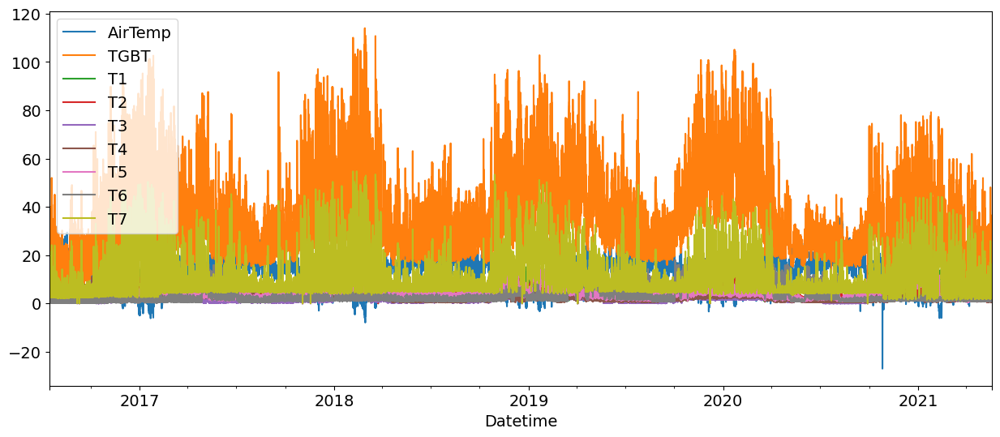

In [6]:
df.plot(figsize=(15,6))

In [7]:
def plot_saisonal_decomp(data):
    # Perform seasonal decomposition
    result = seasonal_decompose(data)

    # Extract the components
    trend = result.trend
    seasonal = result.seasonal
    residual = result.resid

    # Create a dataframe with the original data and the decomposition components
    df_seasonality=pd.DataFrame({'original': data, 'trend': trend, 'seasonality': seasonal, 'residual': residual})



    fig, axes = plt.subplots(nrows=4,ncols=1,figsize=(30,20))

    axes[0].plot(df_seasonality['trend'][:500],'r',label='trend')
    axes[0].plot(df_seasonality['seasonality'][:500],label='seasonality')
    axes[0].plot(df_seasonality['residual'][:500],label='residual')


    axes[1].plot(df_seasonality['trend'][3100:3600],'r',label='trend')
    axes[1].plot(df_seasonality['seasonality'][3100:3600],label='seasonality')
    axes[1].plot(df_seasonality['residual'][3100:3600],label='residual')

    axes[2].plot(df_seasonality['trend'][4000:4500],'r',label='trend')
    axes[2].plot(df_seasonality['seasonality'][4000:4500],label='seasonality')
    axes[2].plot(df_seasonality['residual'][4000:4500],label='residual')

    axes[3].plot(df_seasonality['trend'][-500:],'r',label='trend')
    axes[3].plot(df_seasonality['seasonality'][-500:],label='seasonality')
    axes[3].plot(df_seasonality['residual'][-500:],label='residual')

    plt.legend()
    plt.show()


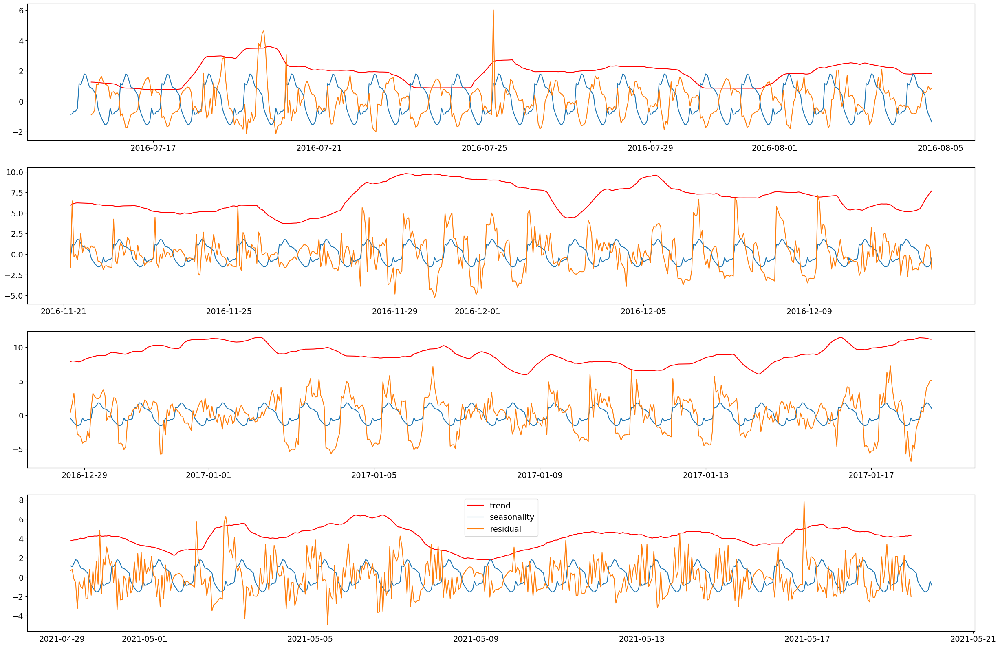

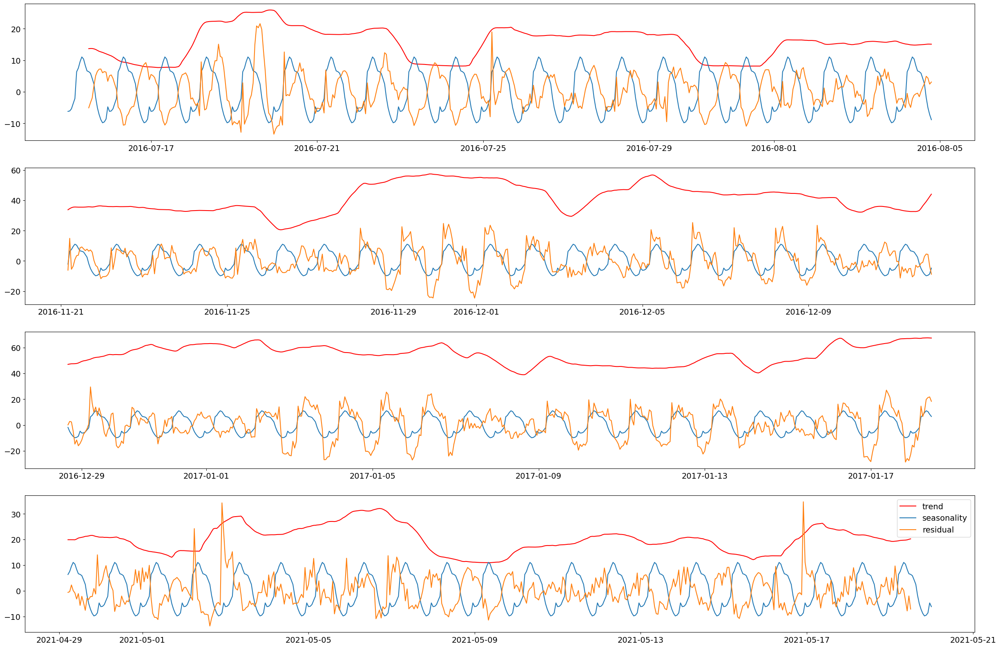

In [8]:
plot_saisonal_decomp(df['T1'])
plot_saisonal_decomp(df['TGBT'])

### gaussian filter

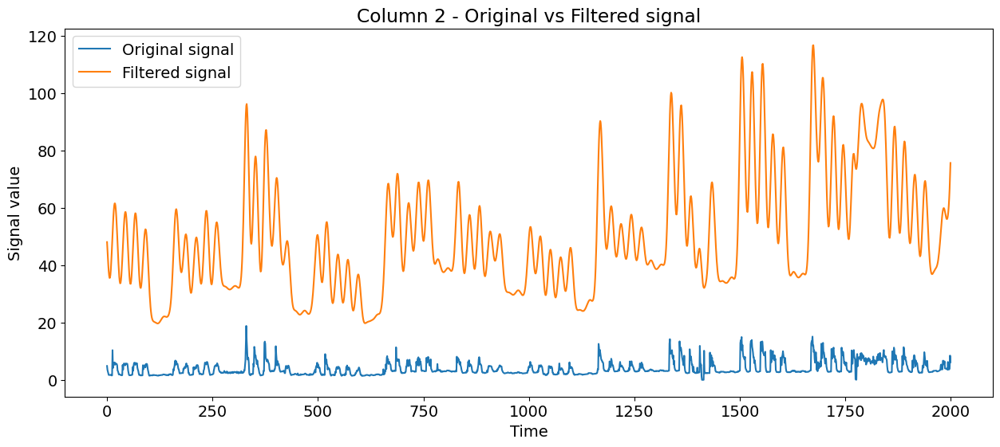

In [9]:
#####################                           gaussian_filter

from scipy import signal

def gaussian_filter(data, kernel_size=31, sigma=5, col=0):
    filtered_data = np.zeros_like(data)
    kernel = signal.gaussian(kernel_size, sigma)

    for i in range(data.shape[1]):
        filtered_data[:, i] = np.convolve(data[:, i], kernel, mode='same')

    # Plot original vs filtered signal for specified column
    fig, ax = plt.subplots(figsize=(15,6))
    ax.plot(data[10000:12000, col], label='Original signal')
    ax.plot(filtered_data[10000:12000, col], label='Filtered signal')
    ax.legend()
    ax.set_xlabel('Time')
    ax.set_ylabel('Signal value')
    ax.set_title('Column {} - Original vs Filtered signal'.format(col))

    return filtered_data

# Apply the Gaussian filter to all columns and plot results for column 2
filtered_data = gaussian_filter(df.values, col=2)

gaussian filter is not satisfying

### wavelet transform

In [10]:
import pywt

def denoise_signal(signal, wavelet='db4', level=4):
    # Decompose signal using wavelet transform
    coeffs = pywt.wavedec(signal, wavelet, level=level)

    # Set threshold level
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))

    # Apply soft thresholding
    for i in range(len(coeffs)):
        coeffs[i] = pywt.threshold(coeffs[i], threshold, 'soft')

    # Reconstruct signal using denoised coefficients
    denoised_signal = pywt.waverec(coeffs, wavelet)

    # Truncate denoised_signal to match df.index length
    denoised_signal = denoised_signal[:len(df.index)]

    return denoised_signal

def denoise_dataframe(df, columns, wavelet='db4', level=4):
    df = df.copy()
    for col in columns:
        df[col+'_denoised'] = denoise_signal(df[col].values, wavelet=wavelet, level=level)
    return df

columns_to_denoise = df.columns
df_wavelet_denoised = denoise_dataframe(df, columns=columns_to_denoise)
df_wavelet_denoised

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7,AirTemp_denoised,TGBT_denoised,T1_denoised,T2_denoised,T3_denoised,T4_denoised,T5_denoised,T6_denoised,T7_denoised
Datetime,,,,,,,,,,,,,,,,,,
2016-07-15 00:00:00+00:00,12.41,9.37,0.99,2.12,0.19,1.50,1.41,0.26,2.64,12.052688,11.239230,0.716789,1.876118,0.409210,1.597901,1.591381,0.444162,3.282791
2016-07-15 01:00:00+00:00,12.12,9.78,0.99,2.17,0.17,1.69,1.57,0.54,2.36,12.134362,11.806967,0.736913,1.847780,0.432052,1.659710,1.615127,0.446560,3.530210
2016-07-15 02:00:00+00:00,11.54,10.95,1.13,2.31,0.34,1.66,1.68,0.33,3.18,12.037935,12.276253,0.760712,1.814549,0.456324,1.766511,1.688879,0.501113,3.744855
2016-07-15 03:00:00+00:00,11.28,13.73,1.31,2.40,0.89,1.64,1.78,0.54,4.81,11.765354,12.595809,0.788473,1.776066,0.481413,1.917176,1.810050,0.611669,3.907426
2016-07-15 04:00:00+00:00,10.77,14.24,1.17,2.29,0.27,2.10,2.10,0.76,5.25,11.811055,12.992496,0.817721,1.735411,0.503055,2.122458,1.984087,0.754220,4.101632
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19 20:00:00+00:00,10.93,15.04,5.31,1.65,2.37,0.51,1.54,0.94,2.22,10.932438,16.327472,3.304813,1.593420,2.418104,0.731369,1.472783,1.232212,4.066673
2021-05-19 21:00:00+00:00,10.10,11.11,2.06,1.02,2.29,0.50,1.50,0.94,2.34,10.109650,17.103358,2.791655,1.703464,2.448705,0.663105,1.432537,1.097499,4.866202
2021-05-19 22:00:00+00:00,9.48,22.12,7.20,2.26,2.31,0.52,1.50,1.02,6.72,9.491692,17.471989,4.255909,1.778596,2.414523,0.585711,1.397925,0.995313,5.304359


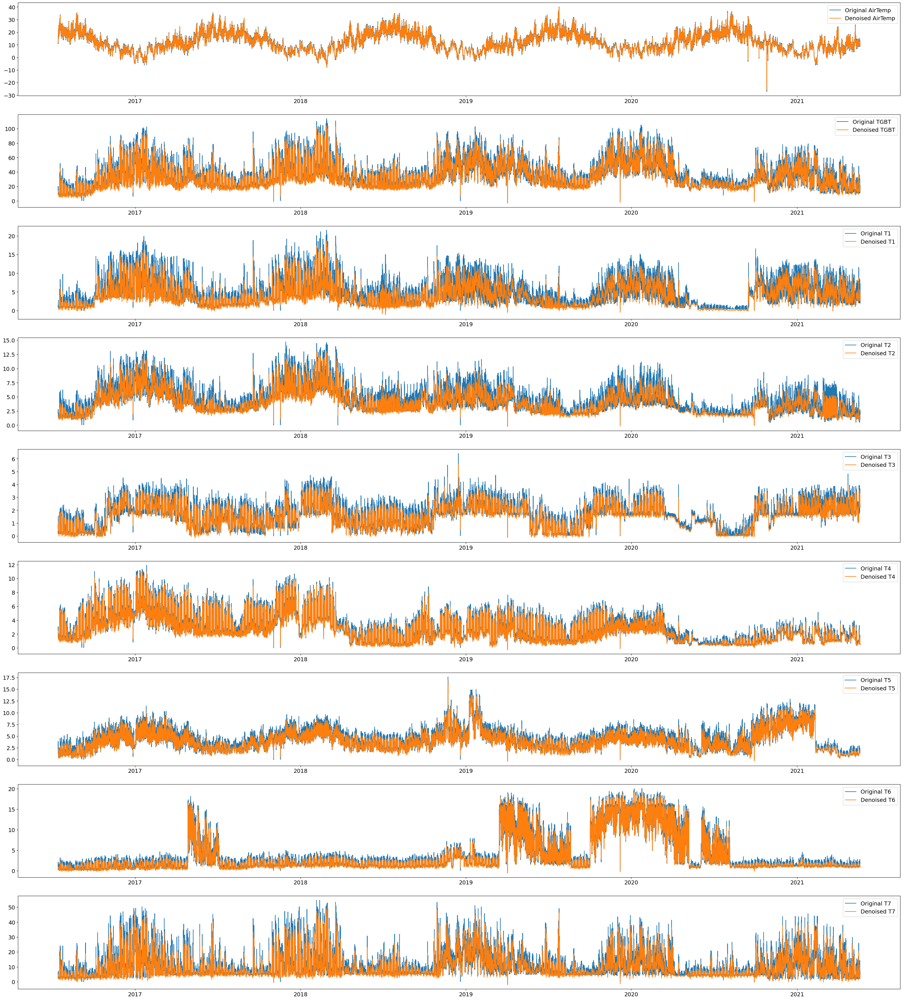

In [11]:

# Plot original and denoised signals
fig, axes = plt.subplots(nrows=len(columns_to_denoise), ncols=1, figsize=(40, 5*len(columns_to_denoise)))

for i, col in enumerate(columns_to_denoise):
    axes[i].plot(df_wavelet_denoised.index.values, df_wavelet_denoised[col], label='Original '+col)
    axes[i].plot(df_wavelet_denoised.index.values, df_wavelet_denoised[col+'_denoised'], label='Denoised '+col)
    axes[i].legend()

plt.show()


### exponential smoothing

In [12]:
from tsmoothie.smoother import *


# note : we lose the first window of data...

# operate smoothing
smoother = ExponentialSmoother(window_len=24*7, alpha=0.7)
smoother.smooth(df.T)
print(smoother.smooth_data.shape)
print(df.shape)


# # generate interval
# low, up = smoother.get_intervals('sigma_interval')

fig, axes = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(200, 5*len(df.columns)))

for i, col in enumerate(columns_to_denoise):
    axes[i].plot(smoother.smooth_data[i][10000:20000], label='Denoised '+col)
    axes[i].plot(smoother.data[i][10000:20000], '.k', label='Original '+col)
    axes[i].legend()

plt.show()


(9, 42313)
(42481, 9)


In [13]:
df_Exponential_filtered = pd.DataFrame(smoother.smooth_data.T, columns = df.columns, index=  df.index[24*7:])
df_Exponential_filtered

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7
Datetime,,,,,,,,,
2016-07-22 00:00:00+00:00,18.642032,7.503340,0.820278,1.421613,0.211394,1.247388,0.741043,0.292034,2.581672
2016-07-22 01:00:00+00:00,18.087610,7.599002,0.848083,1.413484,0.210418,1.263217,0.740313,0.227610,2.713502
2016-07-22 02:00:00+00:00,17.312283,8.355701,0.884425,1.537045,0.287125,1.442965,0.901094,0.194283,2.907051
2016-07-22 03:00:00+00:00,16.792685,11.340710,1.021328,1.847114,1.031138,1.356889,0.942328,0.604285,4.274115
2016-07-22 04:00:00+00:00,16.734805,10.766213,1.055398,1.716134,0.477341,1.541067,1.283698,0.531285,3.914235
...,...,...,...,...,...,...,...,...,...
2021-05-19 20:00:00+00:00,11.340625,14.453716,4.527915,1.472065,2.364538,0.530013,1.544344,1.090655,2.424150
2021-05-19 21:00:00+00:00,10.472188,12.113115,2.800374,1.155620,2.312361,0.509004,1.513303,0.985196,2.365245
2021-05-19 22:00:00+00:00,9.777656,19.117934,5.880112,1.928686,2.310708,0.516701,1.503991,1.009559,5.413574


### Kalman filter

In [14]:
from tsmoothie.smoother import *

smootherKalman = KalmanSmoother(component='level_longseason', 
                          component_noise={'level':0.5, 'longseason':0.5}, 
                          n_longseasons=365)
smootherKalman.smooth(df.T)

print(smootherKalman.smooth_data.shape)
print(df.shape)


fig, axes = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(200, 5*len(df.columns)))

for i, col in enumerate(columns_to_denoise):
    axes[i].plot(smootherKalman.smooth_data[i][10000:20000], label='Denoised '+col)
    axes[i].plot(smootherKalman.data[i][10000:20000], '.k', label='Original '+col)
    axes[i].legend()

plt.show()

(9, 42481)
(42481, 9)


In [15]:
df_Kalman_filtered = pd.DataFrame(smootherKalman.smooth_data.T, columns = df.columns, index=  df.index)
df_Kalman_filtered

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7
Datetime,,,,,,,,,
2016-07-15 00:00:00+00:00,12.020470,9.762996,1.005142,2.139277,0.220838,1.562535,1.493411,0.354013,2.714089
2016-07-15 01:00:00+00:00,11.931977,10.377183,1.043527,2.200620,0.258796,1.658924,1.605461,0.457935,2.858997
2016-07-15 02:00:00+00:00,11.657109,11.588609,1.135490,2.292314,0.385632,1.724174,1.752717,0.479845,3.503388
2016-07-15 03:00:00+00:00,11.501161,13.438205,1.232961,2.366022,0.558130,1.853504,1.972369,0.651631,4.471399
2016-07-15 04:00:00+00:00,11.568311,14.994862,1.253383,2.405428,0.398743,2.196184,2.383967,0.935008,5.100684
...,...,...,...,...,...,...,...,...,...
2021-05-19 20:00:00+00:00,11.026356,14.531728,4.163156,1.447063,2.354509,0.543158,1.535032,1.093260,2.888102
2021-05-19 21:00:00+00:00,10.265516,14.700261,3.857053,1.463765,2.316016,0.524754,1.508911,1.008672,3.512061
2021-05-19 22:00:00+00:00,9.669959,18.459616,5.347729,1.924548,2.303431,0.531120,1.491621,0.992718,5.308793


In [16]:
def Kalman_filter(df, level=0.5, longseason = 0.5):
  smootherKalman = KalmanSmoother(component='level_longseason', 
                          component_noise={'level':level, 'longseason':longseason}, 
                          n_longseasons=365)
  smootherKalman.smooth(df.T)
  df_Kalman_filtered = pd.DataFrame(smootherKalman.smooth_data.T, columns = df.columns, index=  df.index)
  
  return df_Kalman_filtered

# data analysis

## auto-correlation

In [17]:
from matplotlib import rcParams
from statsmodels.graphics.tsaplots import plot_acf

# rcParams["figure.figsize"] = 13, 8
# # rcParams["figure.figsize"] = 10, 3

# # ACF function up to 3024 lags
# plot_acf(df_Kalman_filtered["T1"], lags=24*30,use_vlines =False,title='T1 Autocorrelation for 1 month')
# plot_acf(df_Kalman_filtered["T1"], lags=24*30*2,use_vlines =False,title='T1 Autocorrelation for 2 month')
# plot_acf(df_Kalman_filtered["T1"], lags=30*24*12,use_vlines =False,title='T1 Autocorrelation for 1 year')

# plot_acf(df_Kalman_filtered["TGBT"], lags=24*30,use_vlines =False,title='TGBT Autocorrelation for 1 month')
# plot_acf(df_Kalman_filtered["TGBT"], lags=24*30*2,use_vlines =False,title='TGBT Autocorrelation for 2 month')
# plot_acf(df_Kalman_filtered["TGBT"], lags=30*24*12,use_vlines =False,title='TGBT Autocorrelation for 1 year')

# plt.show()

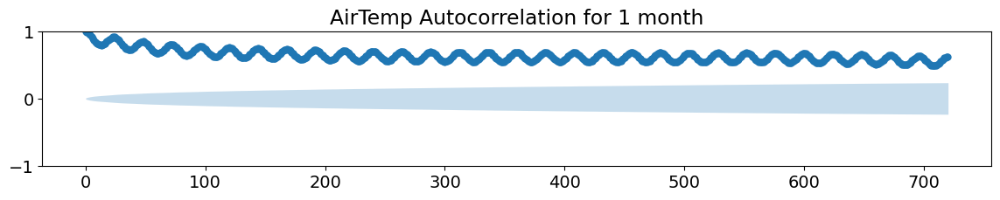

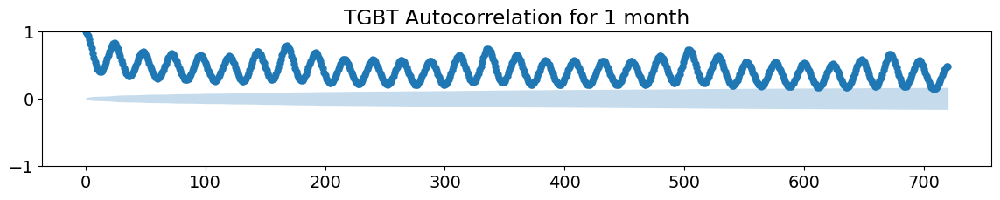

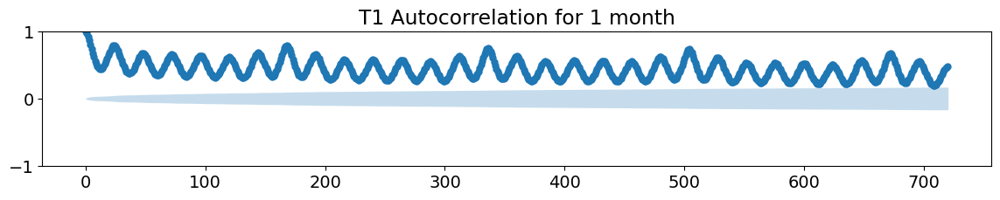

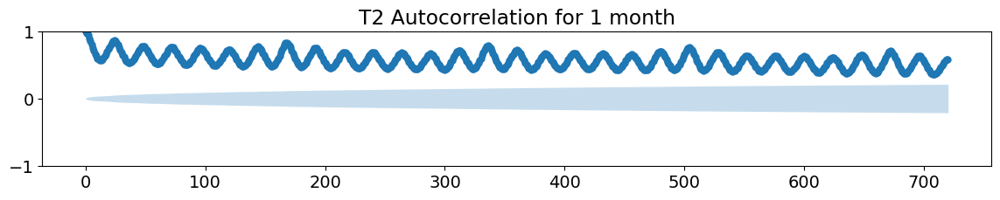

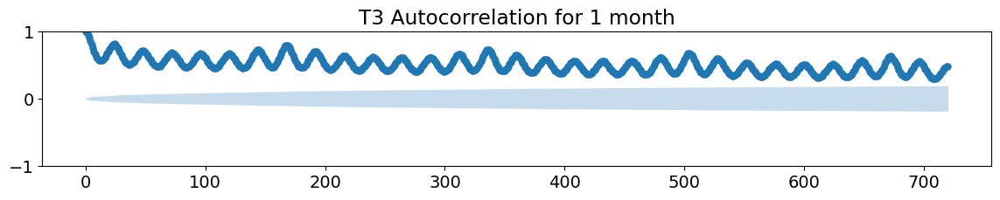

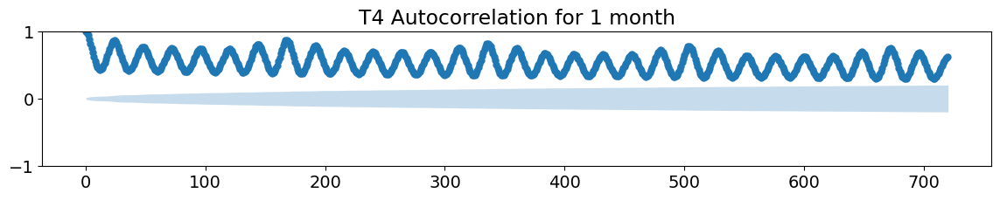

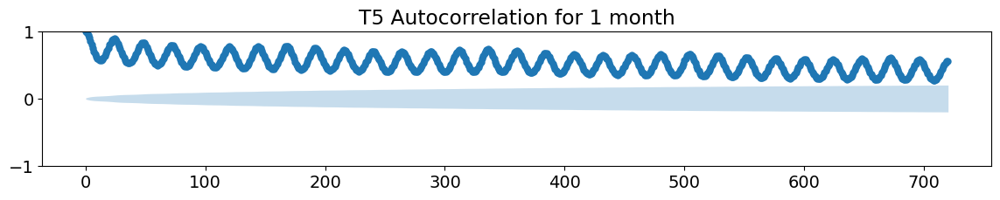

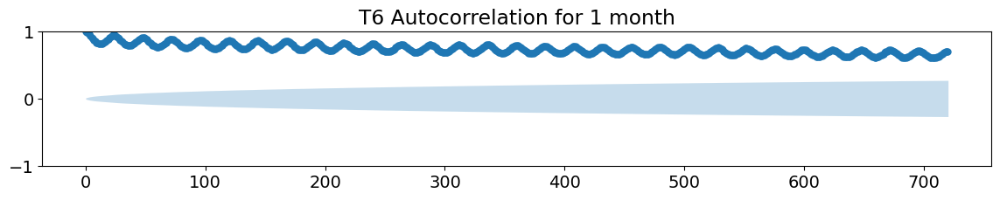

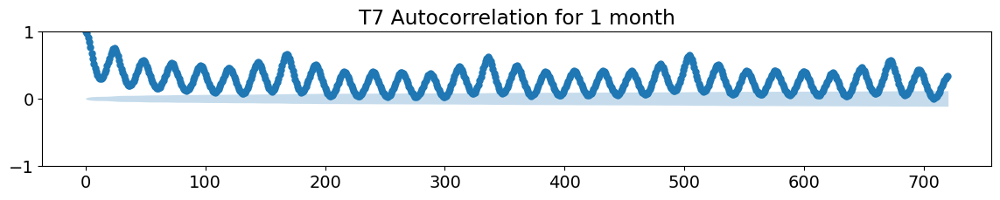

In [18]:
rcParams["figure.figsize"] = 14, 2

for col in df_Kalman_filtered.columns:
  plot_acf(df_Kalman_filtered[col], lags=24*30,use_vlines =False,title=f'{col} Autocorrelation for 1 month')
plt.show()

## Features extraction


In [19]:
from sklearn.preprocessing import StandardScaler
from scipy.interpolate import BSpline


def create_features(df,Fourier_terms=True, B_spline_features=True):
    """
    Create time series features based on time series index, also can add :
    Fourier_terms
    B_spline_features
    """
    df = df.copy()

    # Extract time-based features
    df['year'] = df.index.year
    df['month'] = df.index.month
    df['day'] = df.index.day
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['dayofyear'] = df.index.dayofyear
    
    # Extract Fourier terms
    
    if Fourier_terms:
        """
        Fourier terms to capture seasonality patterns in the data.
        The Fourier terms are sinusoidal functions of the day/hour of year,
        with different frequencies (2, 4, 6, 8 cycles per year) and transformations
        """
        dayofyear = df.index.dayofyear
        hour = df.index.hour
        freq24 = 2 * np.pi / 24
        freq365 = 2 * np.pi / 365

        df['sin24_2'] = np.sin(freq24 * hour * 2)
        df['sin24_4'] = np.sin(freq24 * hour * 4)
        df['cos24_2'] = np.cos(freq24 * hour * 2)
        df['cos24_4'] = np.cos(freq24 * hour * 4)
        df['tanh24_2'] = np.tanh(freq24 * hour * 2)
        df['tanh24_4'] = np.tanh(freq24 * hour * 4)
        df['sin24_6'] = np.sin(freq24 * hour * 6)
        df['cos24_6'] = np.cos(freq24 * hour * 6)
        df['tanh24_6'] = np.tanh(freq24 * hour * 6)

        df['sin365_2'] = np.sin(freq365 * dayofyear * 2)
        df['cos365_2'] = np.cos(freq365 * dayofyear * 2)
        df['tanh365_2'] = np.tanh(freq365 * dayofyear * 2)
        df['sin365_4'] = np.sin(freq365 * dayofyear * 4)
        df['cos365_4'] = np.cos(freq365 * dayofyear * 4)
        df['tanh365_4'] = np.tanh(freq365 * dayofyear * 4)
        df['sin365_6'] = np.sin(freq365 * dayofyear * 6)
        df['cos365_6'] = np.cos(freq365 * dayofyear * 6)
        df['tanh365_6'] = np.tanh(freq365 * dayofyear * 6)

        # Fit scaler only once and transform Fourier terms
        fourier_cols = ['sin24_2', 'sin24_4', 'cos24_2', 'cos24_4',
                         'tanh24_2', 'tanh24_4',"sin24_6",
                        "cos24_6","tanh24_6","sin365_2","cos365_2",
                        "tanh365_2","sin365_4","cos365_4","tanh365_4",
                        "sin365_6","cos365_6","tanh365_6"]
    
        scaler = StandardScaler()
        df[fourier_cols] = scaler.fit_transform(df[fourier_cols])
        
#         for x in fourier_cols:
#             scaler = StandardScaler()
#             df[x] = scaler.fit_transform(df[x].values.reshape(-1,1))
        

    
    if B_spline_features:
        # Create B-spline features based on time series index
        """
        B-splines: B-splines are a family of piecewise polynomial functions that
        are commonly used in computer graphics, numerical analysis, and computational geometry
        to represent curves and surfaces. B-splines can be used to represent periodic signals by fitting a linear combination of
        basis functions to the signal. The basis functions are defined by a set of control points and a degree parameter,
        and they are non-zero only on a small interval of the signal. The B-spline representation can be more flexible
        than the Fourier or polynomial representations because it can capture both sharp transitions and smooth variations in 
        the signal.

        The function first creates a sequence of knot points t evenly spaced along the time series index.
        It then creates a B-spline object spl with n_knots basis functions of degree degree using the knot points as input.
        Finally, it evaluates the B-spline object at each time index x to obtain the B-spline basis functions
        and adds them as columns to the DataFrame with names 'b_spline_0', 'b_spline_1', etc.

        """
        x = df.index.values.astype(float)
        degree=5
        n_knots=8

        t = np.linspace(x.min(), x.max(), n_knots + degree - 1)
        spl = BSpline(t, np.eye(n_knots), k=degree)
        for i in range(n_knots-4):
            col_name = f'b_spline_{i}'
            df[col_name] = spl(x)[:, i]
    
    df.dropna(inplace=True)
    
    return df

     
    
# df_Kalman_filtered = create_features(df_Kalman_filtered,Fourier_terms=True, B_spline_features=False)

# df_Kalman_filtered.corr()

In [20]:
import datetime

vacances_scolaires = [
    # Vacances de Noël 2016
    (datetime.date(2016, 12, 22), datetime.date(2017, 1, 2)),
    # Vacances d'hiver 2017
    (datetime.date(2017, 2, 16), datetime.date(2017, 2, 26)),
    # Vacances de printemps 2017
    (datetime.date(2017, 4, 13), datetime.date(2017, 4, 23)),
    # Vacances d'été 2017
    (datetime.date(2017, 7, 6), datetime.date(2017, 9, 1)),
    # Vacances de Noël 2017
    (datetime.date(2017, 12, 21), datetime.date(2018, 1, 1)),
    # Vacances d'hiver 2018
    (datetime.date(2018, 2, 15), datetime.date(2018, 2, 25)),
    # Vacances de printemps 2018
    (datetime.date(2018, 4, 5), datetime.date(2018, 4, 15)),
    # Vacances d'été 2018
    (datetime.date(2018, 7, 6), datetime.date(2018, 8, 31)),
    # Vacances de Noël 2018
    (datetime.date(2018, 12, 20), datetime.date(2019, 1, 6)),
    # Vacances d'hiver 2019
    (datetime.date(2019, 2, 14), datetime.date(2019, 2, 24)),
    # Vacances de printemps 2019
    (datetime.date(2019, 4, 4), datetime.date(2019, 4, 14)),
    # Vacances d'été 2019
    (datetime.date(2019, 7, 5), datetime.date(2019, 8, 31)),
    # Vacances de Noël 2019
    (datetime.date(2019, 12, 20), datetime.date(2020, 1, 5)),
    # Vacances d'hiver 2020
    (datetime.date(2020, 2, 13), datetime.date(2020, 2, 23)),
    # Vacances de printemps 2020
    (datetime.date(2020, 4, 3), datetime.date(2020, 4, 12)),
    # Vacances d'été 2020
    (datetime.date(2020, 7, 3), datetime.date(2020, 8, 29)),
    # Vacances de Noël 2020
    (datetime.date(2020, 12, 18), datetime.date(2021, 1, 3)),
    # Vacances d'hiver 2021
    (datetime.date(2021, 2, 11), datetime.date(2021, 2, 21)),
    # Vacances de printemps 2021
    (datetime.date(2021, 4, 2), datetime.date(2021, 4, 11)),
    # Vacances d'été 2021
    (datetime.date(2021, 7, 2), datetime.date(2021, 8, 28))
]

def is_date_in_vacances_scolaires(date, vacances_scolaires):
    date = date.date()
    for start_date, end_date in vacances_scolaires:
        if start_date <= date <= end_date:
            return 1
    return 0


ferie = {
     2016: [datetime.date(2016, 1, 1), # Jour de l'an
         datetime.date(2016, 4, 25), # Lundi de Pâques
         datetime.date(2016, 5, 1), # Fête du travail
         datetime.date(2016, 5, 5), # Victoire des alliés
         datetime.date(2016, 5, 8), # Armistice de 1945
         datetime.date(2016, 5, 16), # Ascension
         datetime.date(2016, 5, 30), # Lundi de Pentecôte
         datetime.date(2016, 7, 14), # Fête nationale
         datetime.date(2016, 8, 15), # Assomption
         datetime.date(2016, 11, 1), # Toussaint
         datetime.date(2016, 11, 11), # Armistice de 1918
         datetime.date(2016, 12, 25) # Noël
         ],
    2017: [datetime.date(2017, 1, 1),  # Jour de l'an
           datetime.date(2017, 4, 17),  # Lundi de Pâques
           datetime.date(2017, 5, 1),  # Fête du travail
           datetime.date(2017, 5, 8),  # Victoire des alliés
           datetime.date(2017, 5, 25),  # Ascension
           datetime.date(2017, 6, 5),  # Lundi de Pentecôte
           datetime.date(2017, 7, 14),  # Fête nationale
           datetime.date(2017, 8, 15),  # Assomption
           datetime.date(2017, 11, 1),  # Toussaint
           datetime.date(2017, 11, 11),  # Armistice de 1918
           datetime.date(2017, 12, 25)  # Noël
           ],
    2018: [datetime.date(2018, 1, 1),  # Jour de l'an
           datetime.date(2018, 4, 2),  # Lundi de Pâques
           datetime.date(2018, 5, 1),  # Fête du travail
           datetime.date(2018, 5, 8),  # Victoire des alliés
           datetime.date(2018, 5, 10),  # Ascension
           datetime.date(2018, 5, 21),  # Lundi de Pentecôte
           datetime.date(2018, 7, 14),  # Fête nationale
           datetime.date(2018, 8, 15),  # Assomption
           datetime.date(2018, 11, 1),  # Toussaint
           datetime.date(2018, 11, 11),  # Armistice de 1918
           datetime.date(2018, 12, 25)  # Noël
           ],
    2019: [datetime.date(2019, 1, 1),  # Jour de l'an
           datetime.date(2019, 4, 22),  # Lundi de Pâques
           datetime.date(2019, 5, 1),  # Fête du travail
           datetime.date(2019, 5, 8),  # Victoire des alliés
           datetime.date(2019, 5, 30),  # Ascension
           datetime.date(2019, 6, 10),  # Lundi de Pentecôte
           datetime.date(2019, 7, 14),  # Fête nationale
           datetime.date(2019, 8, 15),  # Assomption
           datetime.date(2019, 11, 1),  # Toussaint
           datetime.date(2019, 11, 11),  # Armistice de 1918
           datetime.date(2019, 12, 25)  # Noël
           ],
     2020: [datetime.date(2020, 1, 1),  # Jour de l'an
           datetime.date(2020, 4, 13),  # Lundi de Pâques
           datetime.date(2020, 5, 1),  # Fête du travail
           datetime.date(2020, 5, 8),  # Victoire des alliés
           datetime.date(2020, 5, 21),  # Ascension
           datetime.date(2020, 6, 1),  # Lundi de Pentecôte
           datetime.date(2020, 7, 14),  # Fête nationale
           datetime.date(2020, 8, 15),  # Assomption
           datetime.date(2020, 11, 1),  # Toussaint
           datetime.date(2020, 11, 11),  # Armistice de 1918
           datetime.date(2020, 12, 25)  # Noël
           ],
    2021: [datetime.date(2021, 1, 1),  # Jour de l'an
           datetime.date(2021, 4, 5),  # Lundi de Pâques
           datetime.date(2021, 5, 1),  # Fête du travail
           datetime.date(2021, 5, 8),  # Victoire des alliés
           datetime.date(2021, 5, 13),  # Ascension
           datetime.date(2021, 5, 24),  # Lundi de Pentecôte
           datetime.date(2021, 7, 14),  # Fête nationale
           datetime.date(2021, 8, 15),  # Assomption
           datetime.date(2021, 11, 1),  # Toussaint
           datetime.date(2021, 11, 11),  # Armistice de 1918
           datetime.date(2021, 12, 25)  # Noël
           ]
}


def is_date_a_holiday(date, ferie):
    date = date.date()
    for year, holidays in ferie.items():
        if date.year == year:
            for holiday in holidays:
                if date == holiday:
                    return 1
    return 0



covid_confinement = [
#     du 17 mars au 11 mai 2020 non inclus
    (datetime.date(2020, 3, 17), datetime.date(2020, 5, 10)),
#     du 30 octobre au 15 décembre 2020 non inclus
    (datetime.date(2020, 10, 30), datetime.date(2020, 12, 14)),
#     du 3 avril au 3 mai 2021 non inclus
    (datetime.date(2021, 4, 3), datetime.date(2021, 5, 2)),
]


df_Kalman_filtered['is_ferie'] = df_Kalman_filtered.index.map(lambda x: is_date_a_holiday(x, ferie))
df_Kalman_filtered['in_vacances_scolaires'] = df_Kalman_filtered.index.map(lambda x: is_date_in_vacances_scolaires(x, vacances_scolaires))
df_Kalman_filtered['in_covid_confinement'] = df_Kalman_filtered.index.map(lambda x: is_date_in_vacances_scolaires(x, covid_confinement))
df_Kalman_filtered

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7,is_ferie,in_vacances_scolaires,in_covid_confinement
Datetime,,,,,,,,,,,,
2016-07-15 00:00:00+00:00,12.020470,9.762996,1.005142,2.139277,0.220838,1.562535,1.493411,0.354013,2.714089,0,0,0
2016-07-15 01:00:00+00:00,11.931977,10.377183,1.043527,2.200620,0.258796,1.658924,1.605461,0.457935,2.858997,0,0,0
2016-07-15 02:00:00+00:00,11.657109,11.588609,1.135490,2.292314,0.385632,1.724174,1.752717,0.479845,3.503388,0,0,0
2016-07-15 03:00:00+00:00,11.501161,13.438205,1.232961,2.366022,0.558130,1.853504,1.972369,0.651631,4.471399,0,0,0
2016-07-15 04:00:00+00:00,11.568311,14.994862,1.253383,2.405428,0.398743,2.196184,2.383967,0.935008,5.100684,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-19 20:00:00+00:00,11.026356,14.531728,4.163156,1.447063,2.354509,0.543158,1.535032,1.093260,2.888102,0,0,0
2021-05-19 21:00:00+00:00,10.265516,14.700261,3.857053,1.463765,2.316016,0.524754,1.508911,1.008672,3.512061,0,0,0
2021-05-19 22:00:00+00:00,9.669959,18.459616,5.347729,1.924548,2.303431,0.531120,1.491621,0.992718,5.308793,0,0,0


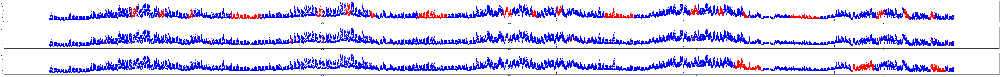

In [21]:
fig, axes = plt.subplots(nrows=3,ncols=1,figsize=(200, 5*3))

color = df_Kalman_filtered['in_vacances_scolaires'].values
color2=df_Kalman_filtered['is_ferie'].values
color3=df_Kalman_filtered['in_covid_confinement'].values

# Define the colors to use based on the value of 'color'
colors = ['red' if c == 1 else 'blue' for c in color]
colors2 = ['red' if c == 1 else 'blue' for c in color2]
colors3 = ['red' if c == 1 else 'blue' for c in color3]


# Plot T with the appropriate colors
axes[0].scatter( df_Kalman_filtered.index, df_Kalman_filtered['TGBT'] ,color=colors)
axes[1].scatter( df_Kalman_filtered.index, df_Kalman_filtered['TGBT'] ,color=colors2)
axes[2].scatter( df_Kalman_filtered.index, df_Kalman_filtered['TGBT'] ,color=colors3)

plt.show()


In [22]:
df_Kalman_filtered.corr()

,AirTemp,TGBT,T1,T2,T3,T4,T5,T6,T7,is_ferie,in_vacances_scolaires,in_covid_confinement
AirTemp,1.000000,-0.551227,-0.637692,-0.573002,-0.489140,-0.362797,-0.541936,-0.196565,-0.475367,0.002529,0.202381,-0.074577
TGBT,-0.551227,1.000000,0.883521,0.815266,0.622350,0.597360,0.660059,0.508906,0.893421,-0.037711,-0.082695,-0.068028
T1,-0.637692,0.883521,1.000000,0.818150,0.642284,0.587914,0.640459,0.223908,0.851262,-0.028488,-0.116545,0.020803
T2,-0.573002,0.815266,0.818150,1.000000,0.563455,0.772473,0.594078,0.138314,0.728397,-0.043094,-0.103366,-0.165822
T3,-0.489140,0.622350,0.642284,0.563455,1.000000,0.512962,0.543713,0.204675,0.495367,-0.056945,-0.152706,0.009042
T4,-0.362797,0.597360,0.587914,0.772473,0.512962,1.000000,0.466138,0.120895,0.445003,-0.072883,-0.146349,-0.160700
T5,-0.541936,0.660059,0.640459,0.594078,0.543713,0.466138,1.000000,0.129514,0.529098,-0.072044,-0.164441,-0.000068
T6,-0.196565,0.508906,0.223908,0.138314,0.204675,0.120895,0.129514,1.000000,0.210811,-0.002552,-0.058205,0.037876
T7,-0.475367,0.893421,0.851262,0.728397,0.495367,0.445003,0.529098,0.210811,1.000000,-0.013292,-0.013174,-0.063367
is_ferie,0.002529,-0.037711,-0.028488,-0.043094,-0.056945,-0.072883,-0.072044,-0.002552,-0.013292,1.000000,0.059260,0.038969


## Rolling statistics

In [23]:

def Rolling_statistics(data, window, target):
    # Parameter validation
    if not isinstance(data, pd.DataFrame):
        raise ValueError("data parameter must be a pandas DataFrame")
    if not isinstance(window, int) or window <= 0:
        raise ValueError("window parameter must be a positive integer")
    if target not in data.columns:
        raise ValueError("target parameter must be a valid column in the data DataFrame")

    # Error handling
    if len(data) < window:
        raise ValueError("window size cannot be larger than the length of the DataFrame")

    # Compute rolling statistics
    data['rolling_24_mean'] = data[target].rolling(window=24).mean()
    data['rolling_24_std'] = data[target].rolling(window=24).std()
    if window >= 7*24:
        data['rolling_7day_mean'] = data[target].rolling(window=7*24).mean()
        data['rolling_7day_std'] = data[target].rolling(window=7*24).std()
    if window >= 7*24*2:
        data['rolling_2week_mean'] = data[target].rolling(window=24*7*2).mean()
        data['rolling_2week_std'] = data[target].rolling(window=24*7*2).std()
    if window >= 7*24*4:
        data['rolling_4week_mean'] = data[target].rolling(window=24*7*4).mean()
        data['rolling_4week_std'] = data[target].rolling(window=24*7*4).std()
        
        # Compute rolling skewness and kurtosis over a window of size 24*7*4
        rolling_skewness = []
        rolling_kurtosis = []

        for i in range(window, len(data)+1):
            vals = data.iloc[i-window:i, :][target].values[[0, 24, 48, 72]]
            rolling_skewness.append(pd.Series(vals).skew())
            rolling_kurtosis.append(pd.Series(vals).kurt())
        data['rolling_4week_skew'] = pd.Series(rolling_skewness, index=data.index[window-1:])
        data['rolling_4week_kurt'] = pd.Series(rolling_kurtosis, index=data.index[window-1:])

    data.dropna(inplace=True)

    return data


## Features selection

In [24]:
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.preprocessing import StandardScaler


def feature_selection_dataframe(data,target_column='TGBT' ,k_best_features = 10):
  data=data.copy()
  # Separate the target variable from the features
  y = data[target_column]
  # Define a list of columns to drop
  columns_to_drop = ['TGBT','T1','T2','T3','T4','T5','T6','T7']

  X = data.copy()
  # Check if each column exists in the DataFrame, and drop it if it does
  for column in columns_to_drop:
      if column in data.columns:
          X = X.drop(column, axis=1)


  # Select the top 10 features based on the F-test
  selector = SelectKBest(score_func=f_regression, k=k_best_features)
  X_new = selector.fit_transform(X, y)

  # Get the names of the selected features
  selected_features = X.columns[selector.get_support()]
  print(f"selected_features : {selected_features}")

  df_new = pd.DataFrame(X_new, columns=selected_features, index= data.index)
  df_new[target_column] = y

  return df_new
  

In [25]:
# feature_selection_dataframe(data= Rolling_statistics(data=df_Kalman_filtered, window=24*7*4, target = 'TGBT'),target_column='TGBT' ,k_best_features = 15)


## Metrics

In [26]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error

def RMSE(y_val,y_pred):
    return np.sqrt(mean_squared_error(y_val, y_pred))

def MAPE(y_true, y_pred):
    return mean_absolute_percentage_error(y_true, y_pred)

def SMAPE(y_true, y_pred):
    n = len(y_true)
    sum_error = 0.0
    for t in range(n):
        sum_error += abs(y_pred[t] - y_true[t]) / (abs(y_true[t]) + abs(y_pred[t]))
    return (100.0/n) * sum_error

def DTW(y_true, y_pred):
    """
     https://dtaidistance.readthedocs.io/en/latest/usage/dtw.html

    If you are interested in comparing only the shape,
    and not the absolute differences and offset, you need to transform the data first.
    Z-normalization
    T = (T-np.mean(T))/np.std(T)
    
    Differencing
    Z-normalization has the disadvantage that constant baselines are not necessarily at the same level.
    The causes a small error but it accumulates over a long distance.
    To avoid this, use differencing (see the clustering K-means documentation for a visual example).
    
    series = dtaidistance.preprocessing.differencing(series, smooth=0.1)
    """
    # Just-in-time Z-normalization
    y_true = (y_true - np.mean(y_true)) / np.std(y_true)
    y_pred = (y_pred - np.mean(y_pred)) / np.std(y_pred)
    
    return dtw.distance_fast(y_true, y_pred,use_pruning=True)

def Temporal_loss(y_true, y_pred, sigma=1):
    """
    Computes the temporal loss between two time series using a modified Time Distortion Index.
    
    Args:
        y_true (ndarray): Ground truth time series.
        y_pred (ndarray): Predicted time series.
        sigma (float): Width of the Gaussian kernel used for temporal weighting.
        
    Returns:
        float: Temporal loss value.
    """
    
    # Compute the time distortion index between y_true and y_pred
    tdi = np.sum(np.abs(y_true - y_pred)) / np.sum(np.abs(y_true))
    
    # Compute the temporal weighting function
    t = np.arange(len(y_true))
    weights = np.exp(-(t - t[:, np.newaxis]) ** 2 / (2 * sigma ** 2))
    
    # Compute the weighted TDI
    weighted_tdi = np.sum(weights * np.abs(y_true - y_pred)) / np.sum(weights * np.abs(y_true))
    
    return weighted_tdi


def PRINT_SCORE(y_val, y_pred):
    
    if isinstance(y_val, np.ndarray):y_val=y_val.ravel()
    if isinstance(y_val, pd.DataFrame):y_val=y_val.values.ravel()
    if isinstance(y_val, pd.Series):y_val=y_val.values.ravel()
   
    if isinstance(y_pred, np.ndarray):y_pred=y_pred.ravel()
    if isinstance(y_pred, pd.DataFrame):y_pred=y_pred.values.ravel()
    if isinstance(y_pred, pd.Series):y_pred=y_pred.values.ravel()
        
    print("RMSE : ",RMSE(y_pred,y_val))
    print("MAPE : ",MAPE(y_pred,y_val))
    print("SMAPE : ",SMAPE(y_pred,y_val))
    print("DTW : ",DTW(np.double(y_pred),np.double(y_val)))
    


RESULT=pd.DataFrame(columns=["model_name","RMSE","MAPE","SMAPE","DTW","RdR_score"])

RESULT_2=pd.DataFrame(columns=["model_name","RMSE","MAPE","SMAPE","DTW"])

RESULT_3=pd.DataFrame(columns=["model_name","window_size","steps_ahead","target_column","RMSE","MAPE","SMAPE","DTW"])

def SCORE_2(model_name, y_pred, y_val, window_size, steps_ahead, target_column, RESULT_3=RESULT_3 ):
    
    if isinstance(y_val, np.ndarray):y_val=y_val.ravel()
    if isinstance(y_val, pd.DataFrame):y_val=y_val.values.ravel()
    if isinstance(y_val, pd.Series):y_val=y_val.values.ravel()
   
    if isinstance(y_pred, np.ndarray):y_pred=y_pred.ravel()
    if isinstance(y_pred, pd.DataFrame):y_pred=y_pred.values.ravel()
    
    temp = pd.DataFrame({"model_name": str(model_name),
                         "window_size" :[window_size],
                         "steps_ahead" :[steps_ahead],
                         "target_column":[target_column],
                    "RMSE": [RMSE(y_pred, y_val)],
                    "MAPE": [MAPE(y_pred, y_val)],
                    "SMAPE": [SMAPE(y_pred, y_val)],
                    "DTW": [DTW(np.double(y_pred), np.double(y_val))]})

    RESULT_3 = pd.concat([RESULT_3, temp])
    return RESULT_3

# Windowing

## Sliding Window

In [27]:
def delete_every_nth_row(df, n):
    """
    This function takes in a pandas DataFrame and deletes every nth row from it. The value of n represents the size of the window or the number of forecasted values.
    It returns a new DataFrame with every nth row deleted.

    Parameters:
        df : pandas DataFrame
            The input DataFrame.
        n : int
            The frequency of rows to be deleted.

    Returns:
        pandas DataFrame
            A new DataFrame with every nth row removed.

    Example:
        df = pd.DataFrame({'A': [1, 2, 3, 4, 5, 6], 'B': [7, 8, 9, 10, 11, 12]})
        new_df = delete_every_nth_row(df, n=2)

        # new_df:
        #    A   B
        # 0  1   7
        # 2  3   9
        # 4  5  11
    """

    mask = pd.Series([True if i % n == 0 else False for i in range(len(df))])
    mask.index = df.index
    return df[mask]


In [28]:
def shiftting_data(data:pd.DataFrame,n_in:int,n_out:int,Target_column:str,dropna:bool=True)-> Tuple[pd.DataFrame,List[str]]:
    """
This function takes a DataFrame and creates new columns by shifting the values of the Target_column by a specified number of positions.
It takes inputs such as the number of time steps to shift the Target_column backwards and forwards, the name of the Target_column, 
and a boolean value indicating whether or not to drop the rows with missing values. It returns the modified DataFrame and a list of the names of the new columns.

Parameters:
    data : pandas DataFrame
        The input DataFrame.
    n_in : int
        The number of time steps to shift the Target_column backwards.
    n_out : int
        The number of time steps to shift the Target_column forwards.
    Target_column : str
        The name of the target column to shift.
    dropna : bool, optional
        A boolean value indicating whether or not to drop rows with missing values. Default is True.

Returns:
    shifted_df : pandas DataFrame
        The modified DataFrame with new columns representing the shifted values of the Target_column.
    new_columns : list of str
        A list of the names of the new columns.

Example:
    df = pd.DataFrame({'Date': ['2021-01-01', '2021-01-02', '2021-01-03'], 'Value': [10, 20, 30]})
    shifted_df, new_columns = shiftting_data(df, n_in=2, n_out=3, Target_column='Value', dropna=True)

    # shifted_df:
    #         Date  Value  Value -1h  Value -2h  Value +1h  Value +2h  Value +3h
    # 2 2021-01-03     30       20.0       10.0        NaN        NaN        NaN

    # new_columns:
    # ['Value', 'Value -1h', 'Value -2h', 'Value +1h', 'Value +2h', 'Value +3h']
"""
    df=data.copy()
    TARGET=str(Target_column)
    col_name=[TARGET]
    
    for k in range(1,n_in+1):
        col=f'{TARGET} -{k}h'
        df[col]=df[TARGET].shift(k)
        col_name.append(col)
        
    for k in range(1,n_out+1):
        col=f'{TARGET} +{k}h'
        df[col]=df[TARGET].shift(-k)
        # col_name.append(col)
    
    df.dropna(inplace=True)
    
    return df,col_name


In [29]:
from scipy.stats import skew
from scipy.stats import kurtosis

def Univariate_X_Y(df,window_size=24,target=24, Target_column = 'TGBT'):
    
    if Target_column != 'AirTemp':
        df = df[['AirTemp', Target_column]].copy()

        # create shifted dataset
        dataT,colname=shiftting_data(df,n_in=window_size-1,n_out=target,Target_column=Target_column)

        # # search for the temperature ----> creates Nan values ...
        # if window_size >=24:
        #     dataT2,_=shiftting_data(df,n_in=24-1,n_out=0,Target_column='AirTemp')

        # else:
        #     dataT2,_=shiftting_data(df,n_in=window_size-1,n_out=0,Target_column='AirTemp')

        # search for the temperature
        dataT2,_=shiftting_data(df,n_in=window_size-1,n_out=0,Target_column='AirTemp')
        dataT2 = dataT2[:-target]

        # fuse
        dataT = pd.concat([dataT2, dataT], axis=1, join='outer')
        #  pandas remove duplicate columns
        dataT = dataT.loc[:,~dataT.columns.duplicated()].copy()

        # delete repeting row based on target
        dataT = delete_every_nth_row(dataT,target)
        dataT['Skew'] = dataT[colname].apply(lambda x: skew(x), axis=1)
        dataT['kurtosis'] = dataT[colname].apply(lambda x: kurtosis(x), axis=1)

    else :
        df = df[['AirTemp']].copy()

        # create shifted dataset
        dataT,colname=shiftting_data(df,n_in=window_size-1,n_out=target,Target_column=Target_column)
        # delete repeting row based on target
        dataT = delete_every_nth_row(dataT,target)

        dataT['Skew'] = dataT[colname].apply(lambda x: skew(x), axis=1)
        dataT['kurtosis'] = dataT[colname].apply(lambda x: kurtosis(x), axis=1)


    # check_missing_dates(dataT,f'{target}H')
    
    # split train and validation
    n = len(dataT)
    train_T = dataT[0:int(n*0.9)]
    val_T = dataT[int(n*0.9):]
    
    # FEATURES and TARGET
    FEATURES=[col for col in dataT.columns if '+' not in col]
    TARGET=[col for col in dataT.columns if '+' in col]
    
    X_train_T=train_T[FEATURES]
    y_train_T=train_T[TARGET]

    X_val_T=val_T[FEATURES]
    y_val_T=val_T[TARGET]
    
    return X_train_T, y_train_T , X_val_T , y_val_T
 
    
X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24,target=24, Target_column = 'TGBT')
print(X_train.shape)
print(y_train.shape)
print(X_val.shape)
print(y_val.shape)

(1592, 50)
(1592, 24)
(177, 50)
(177, 24)


In [30]:
X_train.isna().sum().sum()

0

In [31]:
# def Y_to_forecast(df ,steps_ahead=24, Target_column='T1'):

#     data_df,colname_df=shiftting_data(df[[Target_column]],n_in=0,n_out=steps_ahead,Target_column=Target_column)
#     check_missing_dates(data_df)

#     data_df=data_df[data_df.columns[1:]]

#     Y_df = delete_every_nth_row(data_df,steps_ahead)
#     check_missing_dates(Y_df,f'{steps_ahead}H')
    
#     return Y_df

In [32]:
# def Multivariate_X_Y(df2,window_size=24*7,steps_ahead=24, Target_column ='T1'):
     
#     ####### for the X --> window_size
    
#     X=[]

#     s=df2.iloc[0:0+window_size].values.shape  # for the break

#     for i in range(0,len(df2),steps_ahead):
#         window=df2.iloc[i:i+window_size].values
#         if window.shape != s:
#             break
#         X.append(window)
#     X=np.asarray(X)
    
    
    
#     ####### for the Y --> steps_ahead
#     # we can # check_missing_dates()

#     ## create the predicted values T, T+1 etc... into a dataframe data_df2
#     data_df2,colname_df2=shiftting_data(df2[[Target_column]],n_in=0,n_out=steps_ahead,Target_column=Target_column)

#     check_missing_dates(data_df2)
#     data_df2=data_df2[data_df2.columns[1:]]
#     ## delete every steps_ahead rows to delete the shifted values...
#     Y_df2 = delete_every_nth_row(data_df2,steps_ahead)

#     # check if there is missing dates
#     check_missing_dates(Y_df2,f'{steps_ahead}H')
    
#     ## we may need to reshape ?
#     Y=Y_df2.values.reshape(Y_df2.shape[0],1,Y_df2.shape[1])
    
    
#     ## we should make sure that X and Y have the same length !!
#     a=window_size//24-1
    
#     Y=Y[a:,:,:]
    
#     print("X.shape ",X.shape)
#     print("Y.shape ",Y.shape)
    
#     return X,Y


if we want to evaluate the last "whole" year we yould split with ~0.09 or ~0.1 --> so we will use n=int(X.shape[0]*0.9)

but for 1 absolute year (365 X 24h) ; (365*24)/len(df_Kalman_filtered) = 0.22

In [33]:
# def geneate_train_test(df = df_Kalman_filtered,window_size=24*4*7,steps_ahead=24, Target_column ='T1'):

#   X,Y = Multivariate_X_Y(df2 = df ,window_size=window_size ,steps_ahead=steps_ahead, Target_column =Target_column)

#   n=int(X.shape[0]*0.9)

#   # split train and test 
#   X_train , y_train= X[:n] , Y[:n]
#   X_val,  y_val = X[n:] , Y[n:]

#   return X_train, y_train, X_val, y_val

In [34]:
# X_train, y_train, X_val, y_val = geneate_train_test(df = df_Kalman_filtered,window_size=24*4*7,steps_ahead=24, Target_column ='T1')

## plots

In [35]:
def PLOT_RESULT_3D(y_pred,y_val):
    if isinstance(y_val, np.ndarray):y_val=y_val.ravel()
    if isinstance(y_val, pd.DataFrame):y_val=y_val.values.ravel()
    if isinstance(y_val, pd.Series):y_val=y_val.values.ravel()
   
    if isinstance(y_pred, np.ndarray):y_pred=y_pred.ravel()
    if isinstance(y_pred, pd.DataFrame):y_pred=y_pred.values.ravel()
    if isinstance(y_pred, pd.Series):y_pred=y_pred.values.ravel()
        
    fig, axes = plt.subplots(nrows=4,ncols=1,figsize=(30,20))

    axes[0].plot(y_pred.ravel()[:500],'r',label='prediction model')
    axes[0].plot(y_val.ravel()[:500],label='y_true')
    
    axes[1].plot(y_pred.ravel()[3100:3600],'r',label='prediction model')
    axes[1].plot(y_val.ravel()[3100:3600],label='y_true')

    axes[2].plot(y_pred.ravel()[4000:4500],'r',label='prediction model')
    axes[2].plot(y_val.ravel()[4000:4500],label='y_true')

    axes[3].plot(y_pred.ravel()[-500:],'r',label='prediction model')
    axes[3].plot(y_val.ravel()[-500:],label='y_true')
    
    plt.legend()
    plt.show()


In [36]:
def plot_learning_curve(history, monitor_label = 'val_loss'):
    hist = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch

    min_vec = []
    for i in range(0, len(hist)):
        if i == 0:
            min_vec.append(hist[[monitor_label]].iloc[i, :].values[0])
        else:
            if hist[[monitor_label]].iloc[i, :].values[0] < np.min(min_vec):
                min_vec.append(hist[[monitor_label]].iloc[i, :].values[0])
            else:
                min_vec.append(np.min(min_vec))

    hist['best_from_start'] = min_vec
    hist['improved'] = np.where(hist['best_from_start'] == hist[monitor_label], 1, 0)
            

    best_epoch = hist[hist[monitor_label] == np.min(hist[monitor_label])]['epoch'].values[0]

    plt.figure(figsize = (10, 5))
    plt.plot(hist[monitor_label], label = monitor_label)
    try:
        plt.plot(hist['loss'], label = 'loss')
    except:
        pass
    #plt.plot(hist[monitor_label], label = 'val_loss')

    plt.scatter(hist[hist['improved'] == 1]['epoch'], hist[hist['improved'] == 1][monitor_label], color = 'green', label = 'Improved')
    plt.legend()
    plt.title('Learning curve'
              '\n' + 'best epoch:' + str(best_epoch) + '(' + str(round(np.min(hist[monitor_label]), 3)) + ')')
    
def Plot_History_val_loss(history):
    monitor_label = 'val_loss'
    plot_learning_curve(history)
    max_epoch = np.max(history.epoch)
    hist = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch
    best_epoch = hist[hist[monitor_label] == np.min(hist[monitor_label])]['epoch'].values[0]
    print('max epoch :', max_epoch)

# Machine Learning baseline models

In [37]:
X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=24, Target_column = 'TGBT')
print(X_train.shape)
print(y_train.shape)
print(X_val.shape)
print(y_val.shape)

(1586, 338)
(1586, 24)
(177, 338)
(177, 24)


In [38]:

# from sklearn.linear_model import LinearRegression
# from sklearn.neighbors import KNeighborsRegressor
# from sklearn.model_selection import GridSearchCV
# from sklearn.neural_network import MLPRegressor
# from xgboost import XGBRegressor


# List_model = [LinearRegression(),KNeighborsRegressor(),MLPRegressor(),XGBRegressor()]

# for model in List_model:
    

#     model.fit(X_train,y_train)
    
#     y_pred=model.predict(X_val)
#     y_pred=pd.DataFrame(y_pred)

#     print(f'{model}')
#     PRINT_SCORE(y_val, y_pred)
    

#     RESULT_3=SCORE_2(model_name= f"{model}", y_pred=y_pred, y_val=y_val,target_column="TGBT", window_size=24*7, steps_ahead=24, RESULT_3=RESULT_3 )
# RESULT_3


In [39]:
# List_model = [LinearRegression(),MLPRegressor()]

# all_target=[k for k in range(1,25)]
# all_column=["TGBT","T1"	,"T2",	"T3",	"T4",	"T5"	,"T6"	,"T7"]

# for model in List_model:
#     for target in all_target:
#         for col in all_column:
#             X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=target, Target_column = col)
#             model.fit(X_train,y_train)
            
#             y_pred=model.predict(X_val)
#             y_pred=pd.DataFrame(y_pred)

#             print(f'{model}')
#             PRINT_SCORE(y_val, y_pred)
        

#             RESULT_3=SCORE_2(model_name= f"{model}", y_pred=y_pred, y_val=y_val,target_column=col, window_size=24*7, steps_ahead=target, RESULT_3=RESULT_3 )
# RESULT_3
# pd.read_csv("/home/AAurus/recherche_aurelien/Recherche/Resultat/Result_ML_168in.csv")



In [40]:
# # Create the XGBoost regressor
# reg_xgb = XGBRegressor()

# # Create the XGBoost regressor parameters
# params = {
#     'n_estimators': [200, 500],
#     'learning_rate': [0.01,0.05]
# }

# # Create the grid search object
# gs = GridSearchCV(reg_xgb, params,n_jobs=-1 ,cv=4,verbose=0)

# # Fit the grid search object to the training data
# gs.fit(X_train, y_train)

# # Get the best hyperparameters
# best_params = gs.best_params_

# # Get the best score
# best_score = gs.best_score_

# print(best_params,best_score)

# # n_estimators=1000,early_stopping_rounds=50,learning_rate=0.05

# Deep Learning models

In [41]:
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=15)
# mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)
# callbacks=[es, mc]

In [42]:

# class DtwLoss(tf.keras.losses.Loss):
#     def __init__(self, batch_size: int = 32):
#         super(DtwLoss, self).__init__()
#         self.batch_size = batch_size

#     def call(self, y_true, y_pred):
#         tmp = []
#         for item in range(self.batch_size):
#             tf.print(f'Working on batch: {item}\n')
#             s = y_true[item, :]
#             t = y_pred[item, :]
#             n, m = len(s), len(t)
#             dtw_matrix = []
#             for i in range(n + 1):
#                 line = []
#                 for j in range(m + 1):
#                     if i == 0 and j == 0:
#                         line.append(0)
#                     else:
#                         line.append(np.inf)
#                 dtw_matrix.append(line)

#             for i in range(1, n + 1):
#                 for j in range(1, m + 1):
#                     cost = tf.abs(s[i - 1] - t[j - 1])
#                     last_min = tf.reduce_min([dtw_matrix[i - 1][j], dtw_matrix[i][j - 1], dtw_matrix[i - 1][j - 1]])
#                     dtw_matrix[i][j] = tf.cast(cost, dtype=tf.float32) + tf.cast(last_min, dtype=tf.float32)

#             temp = []
#             for i in range(len(dtw_matrix)):
#                 temp.append(tf.stack(dtw_matrix[i]))

#             tmp.append(tf.stack(temp)[n, m])
#         return tf.reduce_mean(tmp)
# model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss=DtwLoss(batch_size=1))

## CNN_LTSM

In [43]:
def CNN_LSTM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):
    # 
    n_targets = y_train.shape[2]

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv1D(filters=96, kernel_size=1, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(tf.keras.layers.Conv1D(filters=128, kernel_size=1, activation='relu'))
    model.add(tf.keras.layers.Dropout(0.4))
    model.add(tf.keras.layers.MaxPooling1D(pool_size=1))
    model.add(tf.keras.layers.LSTM(256))
    model.add(tf.keras.layers.Dense(steps_ahead))

    # Compile the model
    model.compile(optimizer='adam', loss='mean_squared_error')
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=15)
    history=model.fit(X_train, y_train, epochs=30, batch_size=32, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)

    y_pred = model.predict(X_val)

    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "CNN_LSTM", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

In [44]:
# window_size =24*7
# target = 24
# X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=window_size,target=target, Target_column = 'TGBT')

# X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
# y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
# X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
# y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])


# CNN_LSTM(X_train,y_train, X_val, y_val, window_size=window_size, steps_ahead=target, RESULT_3=RESULT_3)

In [45]:
y_train.shape

(1586, 24)

## SEQ2SEQ

In [46]:
# ##################################### test
# window_size =24*7
# target = 24
# X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=window_size,target=target, Target_column = 'TGBT')

# X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
# y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
# X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
# y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])

# n_features = X_train.shape[2]
# n_steps = X_train.shape[1]
# n_targets = y_train.shape[2]

# input_dim = n_features # 24*7
# output_dim = n_targets # 24

# model = Sequential()
# # Encoder
# model.add(LSTM(units=50, return_sequences=False, activation = 'tanh',input_shape=(n_steps, n_features)))
# model.add(Dense(150, activation="relu") )
# #Use "RepeatVector" to copy N copies of Encoder's output (last time step) as Decoder's N inputs
# model.add(RepeatVector(output_dim))
# # Decoder (second LSTM) 
# model.add(LSTM(units=input_dim, activation = 'tanh', return_sequences=True) )
# # TimeDistributed is to ensure consistency between Dense and Decoder
# model.add(TimeDistributed(Dense(output_dim, activation="linear")) )

# # Compile the model
# # model.compile(optimizer='adam', loss='mean_squared_error')
# opt = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(optimizer=opt, loss='mse')
# # fit model
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)
# history=model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)

# y_pred = model.predict(X_val)
# y_pred=y_pred[:,-1,:]
# PRINT_SCORE(y_val, y_pred)


In [47]:
# PLOT_RESULT_3D(y_pred,y_val)

In [48]:
def Seq2Seq(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):

    n_features = X_train.shape[2]
    n_steps = X_train.shape[1]
    n_targets = y_train.shape[2]

    input_dim = n_features # 24*7
    output_dim = n_targets # 24

    model = Sequential()
    # Encoder
    model.add(LSTM(units=50, return_sequences=False, activation = 'tanh',input_shape=(n_steps, n_features)))
    model.add(Dense(150, activation="relu") )
    #Use "RepeatVector" to copy N copies of Encoder's output (last time step) as Decoder's N inputs
    model.add(RepeatVector(output_dim))
    # Decoder (second LSTM) 
    model.add(LSTM(units=input_dim, activation = 'tanh', return_sequences=True) )
    # TimeDistributed is to ensure consistency between Dense and Decoder
    model.add(TimeDistributed(Dense(output_dim, activation="linear")) )

    # Compile the model
    # model.compile(optimizer='adam', loss='mean_squared_error')
    opt = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, amsgrad=True)
    model.compile(optimizer=opt, loss='mse')
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)
    history=model.fit(X_train, y_train, epochs=30, batch_size=32, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)

    y_pred = model.predict(X_val)
    y_pred=y_pred[:,-1,:]
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "Seq2Seq", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

## TCN_LTSM


In [49]:
# i = Input(shape=(X_train.shape[1], X_train.shape[2]))
# m = TCN(nb_filters=32,
#                  kernel_size=16,
#                  nb_stacks=4,
#                  dilations=(2, 4, 8, 16, 32, 64),
#                  padding='causal',
#                  use_skip_connections=True,
#                  dropout_rate=0.0,
#                  activation='tanh',
#                  kernel_initializer='glorot_uniform',
#                  use_batch_norm=False,
#                  use_layer_norm=False,
#                  use_weight_norm=False,
#         return_sequences = True)(i)
# m = Bidirectional(LSTM(input_dim, return_sequences=False, activation = 'tanh'))(m)
# #m = TimeDistributed(Dense(output_dim, activation = 'linear'))(m)
# m = Dense(n_targets, activation='linear')(m)

# model = Model(inputs=[i], outputs=[m])

# opt = tf.keras.optimizers.Adam(learning_rate=0.0001)
# model.compile(loss='mse', optimizer=opt)

# # fit model
# history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)
# PLOT_RESULT_3D(y_pred,y_val)
# # RESULT_3=SCORE_2(model_name= "Seq2Seq", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )


In [50]:
def TCN_LTSM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):

    n_features = X_train.shape[2]
    n_steps = X_train.shape[1]
    n_targets = y_train.shape[2]

    input_dim = n_features # 24*7
    output_dim = n_targets # 24

    i = Input(shape=(X_train.shape[1], X_train.shape[2]))
    m = TCN(nb_filters=32,
                    kernel_size=16,
                    nb_stacks=4,
                    dilations=(2, 4, 8, 16, 32, 64),
                    padding='causal',
                    use_skip_connections=True,
                    dropout_rate=0.0,
                    activation='tanh',
                    kernel_initializer='glorot_uniform',
                    use_batch_norm=False,
                    use_layer_norm=False,
                    use_weight_norm=False,
        return_sequences = True)(i)
    m = Bidirectional(LSTM(input_dim, return_sequences=False, activation = 'tanh'))(m)
    #m = TimeDistributed(Dense(output_dim, activation = 'linear'))(m)
    m = Dense(n_targets, activation='linear')(m)

    model = Model(inputs=[i], outputs=[m])

    opt = tf.keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(loss='mse', optimizer=opt)

    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)

    history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)


    y_pred = model.predict(X_val)
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "TCN_LTSM", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

## Attention-BiLSTM


In [51]:
# model = Sequential()
# model.add(Bidirectional(LSTM(units=input_dim, 
#                              return_sequences=True, 
#                              kernel_initializer = 'uniform',
#                              activation = 'tanh'
#                              )))
# model.add(SeqSelfAttention(attention_activation = 'linear'))
# model.add(TimeDistributed(Dense(units=output_dim, activation = None)))

# #opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
# opt = tf.keras.optimizers.Adam(learning_rate=0.0005)#, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)
# PLOT_RESULT_3D(y_pred,y_val)

In [52]:
# X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=2, Target_column = 'TGBT')
# X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
# y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
# X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
# y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])

# n_features = X_train.shape[2]
# n_steps = X_train.shape[1]
# n_targets = y_train.shape[2]

# input_dim = n_features # 24*7
# output_dim = n_targets # 24
# model = Sequential()
# model.add(Bidirectional(LSTM(units=input_dim, 
#                              return_sequences=True, 
#                              kernel_initializer = 'uniform',
#                              activation = 'tanh'
#                              )))
# model.add(SeqSelfAttention(attention_activation = 'linear'))
# model.add(TimeDistributed(Dense(units=output_dim, activation = None)))

# #opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
# opt = tf.keras.optimizers.Adam(learning_rate=0.0005)#, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

# history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es,mc])


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)
# PLOT_RESULT_3D(y_pred,y_val)

In [53]:
def Attention_BiLSTM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):

    n_features = X_train.shape[2]
    n_steps = X_train.shape[1]
    n_targets = y_train.shape[2]

    input_dim = n_features # 24*7
    output_dim = n_targets # 24

    model = Sequential()
    model.add(Bidirectional(LSTM(units=input_dim, 
                                return_sequences=True, 
                                kernel_initializer = 'uniform',
                                activation = 'tanh'
                                )))
    model.add(SeqSelfAttention(attention_activation = 'linear'))
    model.add(TimeDistributed(Dense(units=output_dim, activation = None)))

    opt = tf.keras.optimizers.Adam(learning_rate=0.0005)#, beta_1=0.9, beta_2=0.999, amsgrad=True)
    model.compile(loss='mse', optimizer=opt)
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)

    history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)


    y_pred = model.predict(X_val)
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "Attention_BiLSTM", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

## SEQ2SEQ_ATTENTION

In [54]:

# input_train = Input(shape=(X_train.shape[1], X_train.shape[2]))
# output_train = Input(shape=(y_train.shape[1], y_train.shape[2]))    

# encoder_stack_h, encoder_last_h, encoder_last_c = LSTM(48, activation='tanh', 
#                                                        dropout=0.2, 
#                                                        recurrent_dropout=0.2, 
#                                                        return_state=True, 
#                                                        return_sequences=True)(input_train)

# decoder_input = RepeatVector(output_train.shape[1])(encoder_last_h)

# decoder_stack_h = LSTM(48, activation='tanh', 
#                        dropout=0.2, 
#                        recurrent_dropout=0.2,
#                        return_state=False, 
#                        return_sequences=True)(decoder_input, initial_state=[encoder_last_h, encoder_last_c])

# attention = dot([decoder_stack_h, encoder_stack_h], axes=[2, 2])
# attention = Activation('softmax')(attention)

# context = dot([attention, encoder_stack_h], axes=[2,1])

# decoder_combined_context = concatenate([context, decoder_stack_h])

# out = TimeDistributed(Dense(y_train.shape[2]))(decoder_combined_context)
# model = Model(inputs=input_train, outputs=out)

# opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=30)
# mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

# history=model.fit(X_train, y_train, epochs=200, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es, mc])


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)
# PLOT_RESULT_3D(y_pred,y_val)

In [55]:
# Plot_History_val_loss(history)

In [56]:
def SEQ2SEQ_ATTENTION(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):

    input_train = Input(shape=(X_train.shape[1], X_train.shape[2]))
    output_train = Input(shape=(y_train.shape[1], y_train.shape[2]))    

    encoder_stack_h, encoder_last_h, encoder_last_c = LSTM(48, activation='tanh', 
                                                        dropout=0.2, 
                                                        recurrent_dropout=0.2, 
                                                        return_state=True, 
                                                        return_sequences=True)(input_train)

    decoder_input = RepeatVector(output_train.shape[1])(encoder_last_h)

    decoder_stack_h = LSTM(48, activation='tanh', 
                        dropout=0.2, 
                        recurrent_dropout=0.2,
                        return_state=False, 
                        return_sequences=True)(decoder_input, initial_state=[encoder_last_h, encoder_last_c])

    attention = dot([decoder_stack_h, encoder_stack_h], axes=[2, 2])
    attention = Activation('softmax')(attention)

    context = dot([attention, encoder_stack_h], axes=[2,1])

    decoder_combined_context = concatenate([context, decoder_stack_h])

    out = TimeDistributed(Dense(y_train.shape[2]))(decoder_combined_context)
    model = Model(inputs=input_train, outputs=out)

    opt = tf.keras.optimizers.Adam(learning_rate=0.0005)#, beta_1=0.9, beta_2=0.999, amsgrad=True)
    model.compile(loss='mse', optimizer=opt)
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)

    history=model.fit(X_train, y_train, epochs=40, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks =es)


    y_pred = model.predict(X_val)
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "SEQ2SEQ_ATTENTION", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

## Multihead_Attention

In [57]:
# X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=2, Target_column = 'TGBT')
# X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
# y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
# X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
# y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])

# n_features = X_train.shape[2]
# n_steps = X_train.shape[1]
# n_targets = y_train.shape[2]

# input_dim = n_features # 24*7
# output_dim = n_targets # 24

# model = Sequential()
# model.add(Bidirectional(LSTM(units=input_dim*3, 
#                              return_sequences=True, 
#                              kernel_initializer = 'uniform',
#                              activation = 'tanh'
#                              )))
# model.add(MultiHeadAttention(head_num = input_dim))
# model.add(Bidirectional(LSTM(input_dim, return_sequences=True, activation = 'tanh')))#,return_sequences=False))
# model.add(TimeDistributed(Dense(units=output_dim, activation = 'linear')))


# opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)
# mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

# history=model.fit(X_train, y_train, epochs=30, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es, mc])


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)
# PLOT_RESULT_3D(y_pred,y_val)

In [58]:
def Multihead_Attention(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):
    n_features = X_train.shape[2]
    n_steps = X_train.shape[1]
    n_targets = y_train.shape[2]

    input_dim = n_features # 24*7
    output_dim = n_targets # 24

    model = Sequential()
    model.add(Bidirectional(LSTM(units=input_dim*3, 
                                return_sequences=True, 
                                kernel_initializer = 'uniform',
                                activation = 'tanh'
                                )))
    model.add(MultiHeadAttention(head_num = input_dim))
    model.add(Bidirectional(LSTM(input_dim, return_sequences=True, activation = 'tanh')))#,return_sequences=False))
    model.add(TimeDistributed(Dense(units=output_dim, activation = 'linear')))


    opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
    model.compile(loss='mse', optimizer=opt)
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=15)
    mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

    history=model.fit(X_train, y_train, epochs=200, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es, mc])


    y_pred = model.predict(X_val)
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "Multihead_Attention", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history


## Time2Vec_BiLTSM

In [59]:
class Time2Vec(Layer):
    
    def __init__(self, output_dim=None, **kwargs):
        self.output_dim = output_dim
        super(Time2Vec, self).__init__(**kwargs)
        
    def build(self, input_shape):

        self.W = self.add_weight(name='W',
                                shape=(input_shape[-1], self.output_dim),
                                initializer='uniform',
                                trainable=True)

        self.P = self.add_weight(name='P',
                                shape=(input_shape[1], self.output_dim),
                                initializer='uniform',
                                trainable=True)

        self.w = self.add_weight(name='w',
                                shape=(input_shape[1], 1),
                                initializer='uniform',
                                trainable=True)

        self.p = self.add_weight(name='p',
                                shape=(input_shape[1], 1),
                                initializer='uniform',
                                trainable=True)

        super(Time2Vec, self).build(input_shape)
        
    def call(self, x):
        
        original = self.w * x + self.p
        sin_trans = K.sin(K.dot(x, self.W) + self.P)
        
        return K.concatenate([sin_trans, original], -1)

In [60]:
# n_features = X_train.shape[2]
# n_steps = X_train.shape[1]
# n_targets = y_train.shape[2]

# input_dim = n_features # 24*7
# output_dim = n_targets # 24

# inp = Input(shape=(X_train.shape[1],
#                X_train.shape[2]))
# x = Time2Vec(120)(inp)
# x = Bidirectional(LSTM(48, activation='tanh', return_sequences = True))(x)
# x = Dense(output_dim)(x)

# model = Model(inp, x)

# opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=30)
# mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

# history=model.fit(X_train, y_train, epochs=200, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es, mc])


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)


In [61]:
def Time2Vec_BiLTSM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):
    n_features = X_train.shape[2]
    n_steps = X_train.shape[1]
    n_targets = y_train.shape[2]

    input_dim = n_features # 24*7
    output_dim = n_targets # 24

    inp = Input(shape=(X_train.shape[1],
               X_train.shape[2]))
    x = Time2Vec(120)(inp)
    x = Bidirectional(LSTM(48, activation='tanh', return_sequences = True))(x)
    x = Dense(output_dim)(x)

    model = Model(inp, x)


    opt = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=True)
    model.compile(loss='mse', optimizer=opt)
    # fit model
    es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)
    mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

    history=model.fit(X_train, y_train, epochs=200, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=[es, mc])


    y_pred = model.predict(X_val)
    PRINT_SCORE(y_val, y_pred)

    RESULT_3=SCORE_2(model_name= "Time2Vec_BiLTSM", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

    return model, history

## Time2Vec_Transformer


In [62]:
class Time2Vec4TF(tf.keras.layers.Layer):
    def __init__(self, seq_len, **kwargs):
        super(Time2Vec4TF, self).__init__()
        self.seq_len = seq_len

    def build(self, input_shape):
        self.weights_linear = self.add_weight(name='weight_linear',
                                    shape=(int(self.seq_len),),
                                    initializer='uniform',
                                    trainable=True)

        self.bias_linear = self.add_weight(name='bias_linear',
                                    shape=(int(self.seq_len),),
                                    initializer='uniform',
                                    trainable=True)

        self.weights_periodic = self.add_weight(name='weight_periodic',
                                    shape=(int(self.seq_len),),
                                    initializer='uniform',
                                    trainable=True)

        self.bias_periodic = self.add_weight(name='bias_periodic',
                                    shape=(int(self.seq_len),),
                                    initializer='uniform',
                                    trainable=True)

    def call(self, x):
        x = tf.math.reduce_mean(x[:,:,:], axis=-1) # Convert (batch, seq_len, 5) to (batch, seq_len)
        time_linear = self.weights_linear * x + self.bias_linear
        time_linear = tf.expand_dims(time_linear, axis=-1) # (batch, seq_len, 1)
        time_periodic = tf.math.sin(tf.multiply(x, self.weights_periodic) + self.bias_periodic)
        time_periodic = tf.expand_dims(time_periodic, axis=-1) # (batch, seq_len, 1)
        return tf.concat([time_linear, time_periodic], axis=-1) # (batch, seq_len, 2
class TransformerEncoder(tf.keras.layers.Layer):
    def __init__(self, embed_dim, num_heads, feed_forward_dim, rate=0.1):
        super().__init__()
        self.attn = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = keras.Sequential(
            [
                layers.Dense(feed_forward_dim, activation="relu"),
                layers.Dense(embed_dim),
            ]
        )
        self.layernorm1 = layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = layers.LayerNormalization(epsilon=1e-6)
        self.dropout1 = layers.Dropout(rate)
        self.dropout2 = layers.Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.attn(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)


class T2VTransformer(keras.Model):
    def __init__(
            self,
            num_hid=64, # embed_dim - num of features
            time_steps=7,
            num_head = 2,
            num_feed_forward=128, # pointwise dim
            num_layers_enc = 4,
            time_embedding = False,
    ):
        super().__init__()
        self.num_hid = num_hid
        if time_embedding:
            self.num_hid += 2
            self.tv = Time2Vec4TF(time_steps)
        else:
            self.tv = None
        self.numlayers_enc = num_layers_enc
        self.enc_input = layers.Input((time_steps, self.num_hid))
        self.encoder = keras.Sequential(
            [self.enc_input]
            + [
                TransformerEncoder(self.num_hid, num_head, num_feed_forward)
                for _ in range(num_layers_enc)
            ]
        )
        self.GlobalAveragePooling1D = layers.GlobalAveragePooling1D(data_format='channels_last')

        self.out = layers.Dense(units=time_steps, activation='linear')   
        # self.out = layers.Dense(units=n_targets, activation='linear')        
        self.concat = tf.keras.layers.Concatenate(axis=-1)
        
    def call(self, inputs):
        if self.tv:
            x = self.tv(inputs)
            x = self.concat([inputs, x])
            x = self.encoder(x)
        else:
            x = self.encoder(inputs)
        x = self.GlobalAveragePooling1D(x)
        y = self.out(x)
        return y

In [63]:
import tensorflow.keras.layers as layers

In [64]:
# # num_heads=1
# num_heads =y_train.shape[2]
# num_layers_enc=1
# num_feed_forward=32
# num_features = X_train.shape[2]
# time_steps = y_train.shape[1]
# # time_steps = n_features
# # epochs = 100
# batch_size = 128

# model = T2VTransformer(num_hid=num_features,
#                        time_steps=time_steps,
#                        time_embedding=True,
#                        num_head=y_train.shape[1],
# #                        num_head=n_features,
#                        num_layers_enc=num_layers_enc,
#                        num_feed_forward=num_feed_forward)

# opt = tf.keras.optimizers.Adam(learning_rate=0.0003, beta_1=0.9, beta_2=0.999, amsgrad=True)
# model.compile(loss='mse', optimizer=opt)
# # fit model
# es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)

# history=model.fit(X_train, y_train, epochs=100, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)


# y_pred = model.predict(X_val)
# PRINT_SCORE(y_val, y_pred)

In [65]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


class Time2VecTransformer(layers.Layer):
    def __init__(self, output_dim, **kwargs):
        super(Time2VecTransformer, self).__init__(**kwargs)
        self.output_dim = output_dim

    def build(self, input_shape):
        self.W = self.add_weight(shape=(input_shape[-1], self.output_dim),
                                 initializer='uniform',
                                 trainable=True)
        self.P = self.add_weight(shape=(input_shape[-1], self.output_dim),
                                 initializer='uniform',
                                 trainable=True)
        self.bias = self.add_weight(shape=(self.output_dim,),
                                    initializer='uniform',
                                    trainable=True)
        super(Time2VecTransformer, self).build(input_shape)

    def call(self, x):
        x_sin = tf.math.sin(tf.matmul(x, self.W) + self.bias)
        x_cos = tf.math.cos(tf.matmul(x, self.P) + self.bias)
        return tf.concat([x_sin, x_cos], axis=-1)

    def get_config(self):
        config = super(Time2VecTransformer, self).get_config()
        config.update({'output_dim': self.output_dim})
        return config


class Time2VecModel(tf.keras.Model):
    def __init__(self, input_shape, time2vec_dim, num_layers, output_dim):
        super(Time2VecModel, self).__init__()
        self.time2vec = Time2VecTransformer(time2vec_dim)
        self.flatten = layers.Flatten()
        self.denses = [layers.Dense(64, activation='relu') for _ in range(num_layers)]
        self.output_layer = layers.Dense(output_dim)

    def call(self, inputs):
        x = self.time2vec(inputs)
        x = self.flatten(x)
        for dense in self.denses:
            x = dense(x)
        x = self.output_layer(x)
        return x



X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=24, Target_column = 'TGBT')
X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])
# Set the input and output dimensions based on the shapes of the training data
num_samples, seq_len, input_dim = X_train.shape
output_dim = y_train.shape[2]

# Instantiate the Time2VecModel and compile it
model = Time2VecModel(input_shape=(seq_len, input_dim), time2vec_dim=2, num_layers=3, output_dim=output_dim)



opt = tf.keras.optimizers.Adam(learning_rate=0.0003, beta_1=0.9, beta_2=0.999, amsgrad=True)

model.compile(loss='mse', optimizer=opt)

es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=5)
history=model.fit(X_train, y_train, epochs=100, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)

y_pred = model.predict(X_val)
PRINT_SCORE(y_val, y_pred)

6/6 [==============================] - 0s 2ms/step
RMSE :  14.616511207747175
MAPE :  0.35749241521462227
SMAPE :  19.673108696020357
DTW :  36.385954209690844


In [66]:
# PLOT_RESULT_3D(y_pred, y_val)

In [67]:
def Time2Vec_Transformer(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column="TGBT", RESULT_3 = RESULT_3):
  # Set the input and output dimensions based on the shapes of the training data
  num_samples, seq_len, input_dim = X_train.shape
  output_dim = y_train.shape[2]

  # Instantiate the Time2VecModel and compile it
  model = Time2VecModel(input_shape=(seq_len, input_dim), time2vec_dim=2, num_layers=3, output_dim=output_dim)



  opt = tf.keras.optimizers.Adam(learning_rate=0.0003, beta_1=0.9, beta_2=0.999, amsgrad=True)

  model.compile(loss='mse', optimizer=opt)

  es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=5)
  history=model.fit(X_train, y_train, epochs=100, batch_size=64, validation_data=(X_val, y_val) ,verbose=0, callbacks=es)

  y_pred = model.predict(X_val)
  PRINT_SCORE(y_val, y_pred)
  RESULT_3=SCORE_2(model_name= "Time2Vec_Transformer", y_pred=y_pred, y_val=y_val,target_column=target_column, window_size=window_size, steps_ahead=steps_ahead, RESULT_3=RESULT_3 )

  return model, history

# RUN MODEL

In [68]:
es = EarlyStopping(monitor='val_loss', mode='auto', verbose=0,patience=10)
mc = ModelCheckpoint('best-model.h5', monitor='val_loss', mode='auto', verbose=0, save_best_only=True)

In [69]:
X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=24*7,target=24, Target_column = 'TGBT')
X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])

In [70]:
# List_model = [LinearRegression(),KNeighborsRegressor(),MLPRegressor(),XGBRegressor()]
# # window_size = [k*24 for k in range(1,5)]
# window_size = 24*7
# steps_ahead =[k for k in range(1,25)]
# all_target=["TGBT","T1","T2","T3","T4","T5","T6","T7"]

# for model in List_model:
#     for s in steps_ahead:
#         X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=window_size,target=s, Target_column = 'TGBT')

#         model.fit(X_train,y_train)
        
#         y_pred=model.predict(X_val)
#         y_pred=pd.DataFrame(y_pred)

#         print(f'{model}')
#         PRINT_SCORE(y_val, y_pred)
        

#         RESULT_3=SCORE_2(model_name= f"{model}", y_pred=y_pred, y_val=y_val,target_column="TGBT", window_size=window_size, steps_ahead=s, RESULT_3=RESULT_3 )
# RESULT_3

In [ ]:
all_window_size = [24*7, 24*7*4 ]
all_steps_ahead =[1,2,24]
all_col=["TGBT","T1","T2","T3","T4","T5","T6","T7"]


for window_size in all_window_size:
    for steps_ahead in all_steps_ahead :
        for col in all_col:
            X_train, y_train , X_val , y_val = Univariate_X_Y(df = df_Kalman_filtered,window_size=window_size,target=steps_ahead, Target_column = col)
            X_train = np.array(X_train).reshape(-1, 1, X_train.shape[1])
            y_train = np.array(y_train).reshape(-1, 1, y_train.shape[1])
            X_val = np.array(X_val).reshape(-1, 1, X_val.shape[1])
            y_val = np.array(y_val).reshape(-1, 1, y_val.shape[1])

            print(f"{window_size} and {steps_ahead} and {col}")
            # run the models
            # CNN_LSTM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col, RESULT_3 = RESULT_3)
            # Seq2Seq(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col, RESULT_3 = RESULT_3)
            TCN_LTSM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3 )
            Attention_BiLSTM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3)
            SEQ2SEQ_ATTENTION(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3)
            Multihead_Attention(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3)
            Time2Vec_BiLTSM(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3)
            Time2Vec_Transformer(X_train,y_train, X_val, y_val, window_size, steps_ahead, target_column=col,RESULT_3 = RESULT_3)

RESULT_3.to_csv("RESULT_3.csv", index=False)

RESULT_3

In [ ]:
RESULT_3

NameError: ignored